# PW 1 - Practical work on SAR imaging : introduction to SAR data and interferometric processing
The aim of this PW is to get familiar with SAR data (high dynamic of the images, complex data with ampltidue and phase). After a first part on the visualization of such data and the understanding of the image content, the second part is dedicated to the processing of phase and interferometric data.

## 1. Analysis of a series of SAR images
In this part, we will have a look at a temporal series of 25 SAR images acquired [from 2015-10-06 to 2016-11-05](https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/PileLely_3072x1024RECALZ4.label), with a time delay of approximately 12 days.

By making use of these SAR images, we will see the main differences with respect to conventional natural images and develop some simple tools to visualize an image, interpret it and detect temporal changes.

In [61]:
# !wget https://perso.telecom-paristech.fr/tupin/TPSAR/mvalab.py

import scipy
from scipy import signal
import scipy.signal
import scipy as spy
import scipy.fftpack
from scipy import ndimage
from scipy import special
from scipy import ndimage
import numpy as np
import math
import matplotlib.pyplot as plt
import mvalab as mvalab
from urllib.request import urlopen
import cmath
# from google_drive_downloader import GoogleDriveDownloader as gdd


plt.rcParams['figure.figsize'] = [8, 8]
plt.rcParams['figure.max_open_warning'] = 30

In [62]:
# Download of the time series
webpage = 'https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/'
imagename = 'lely_tuple_multitemp.IMA'
imaslc = mvalab.imz2mat(webpage+imagename) # complex image

time_series_amp = np.abs(imaslc[0]) # taking an array of shape [n_rows,n_columns,n_dates] in amplitude format

imz2mat : version janvier 2018.  Fichier Ã  ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/pilelely/multitemp/lely_tuple_multitemp.dim
Multitemporal image 25 data
Fichiers PC
Image  complex float
lecture .dim OK -> largeur:512 hauteur:512 profondeur:25
Debug 2 4 512
4 512 <f


### Question 1.1: display a SAR image
SAR images have a long-tailed distribution, making its dynamic range to be wide. Plot the image with matplotlib. What do you see?

It looks like an optical image with a low exposition and a low contrast. How can you improve the contrast of a SAR image, in order to have a more pleasant visualization?
Implement a function to plot a SAR image and comment the results obtained.

A usual way to do this, is the saturate all the values above a certain threshold (often chosen as the mean + 3 times the standard deviation of the image) and do a linear stretching for the other values.
Explain the effect of this processing and what you see in the resulting image.

### Answer 1.1

We see only a few pixels, the others are black.

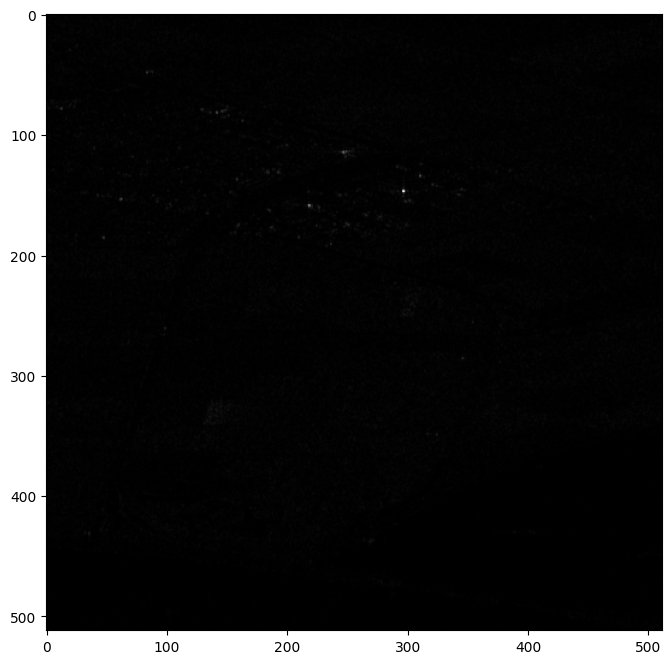

In [63]:
plt.figure()
plt.imshow(time_series_amp[:,:,0],cmap='gray')
plt.show()

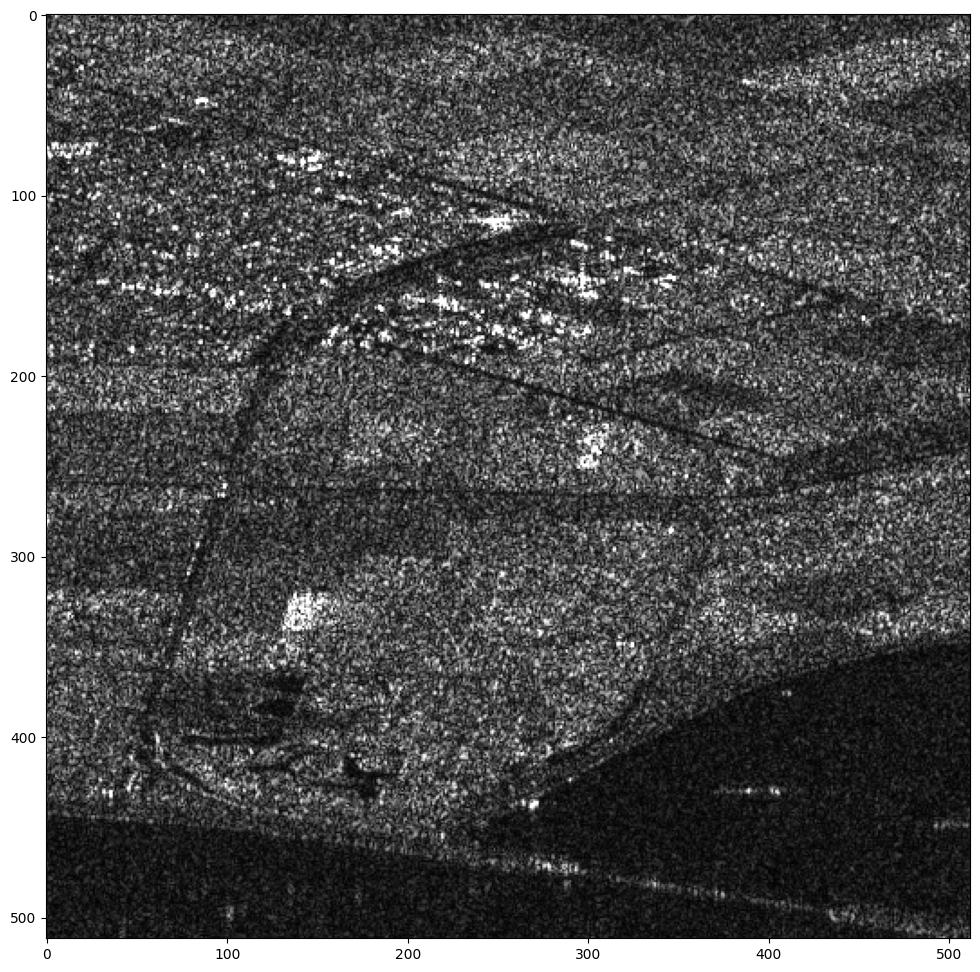

In [64]:
# implement the following function to plot a SAR image
# you can use a threshold as mean + 3 sigma
# and the np.clip function

def plot_sar(ima):
  plt.figure(figsize=(12,12))
  t = np.mean(ima) + 3*np.sqrt(np.var(ima)) # choose the appropriate theshold
  plt.imshow(np.clip(ima, 0, t)/t,cmap='gray') # display the saturated image
  plt.show()

plot_sar(time_series_amp[:,:,0])

### Question 1.2: Image orientation
Is the image in the correct geographic orientation?
Apply the proper flipping if necessary.

To see the corresponding optical image and find the correct flipping, you can have a look on Google Maps at [this location](https://goo.gl/maps/LQcd3Uz9U7qCoRrH6).

### Answer 1.2

No, the image is flipped on the vertical axis.

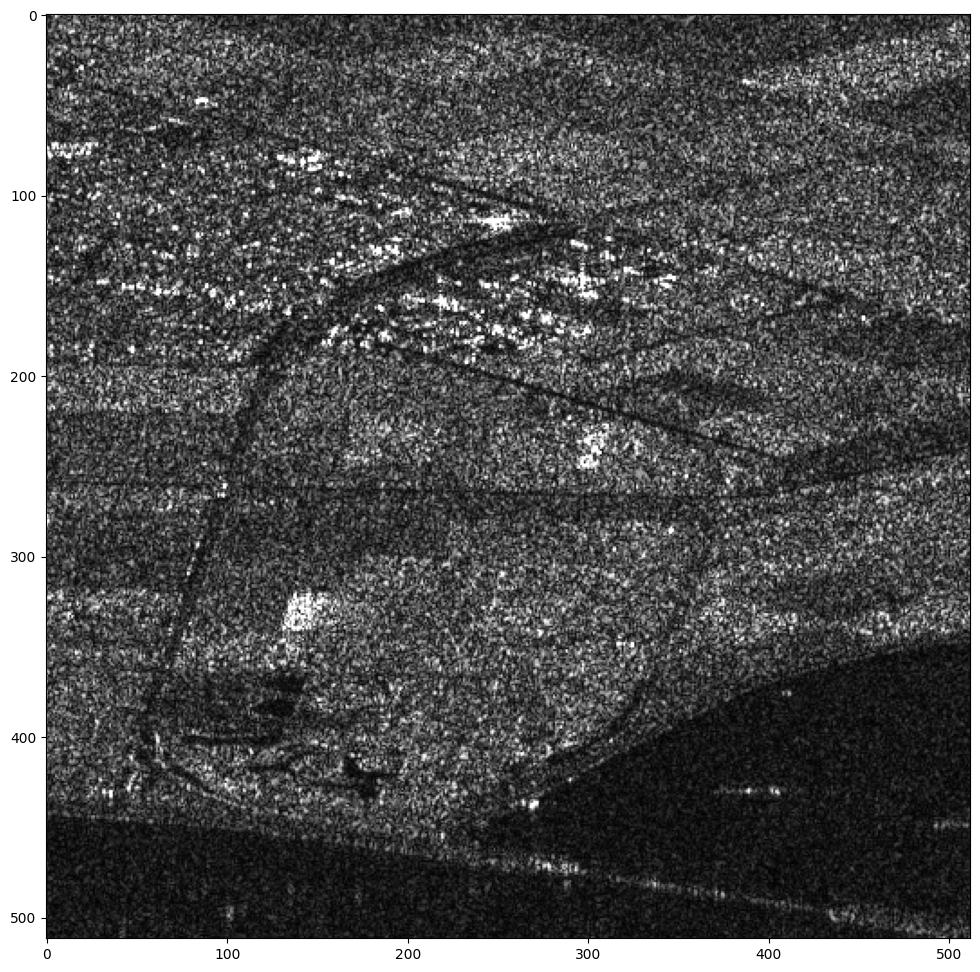

In [65]:
plot_sar(time_series_amp[:,:,0])

In [66]:
time_series_flipped = np.copy(time_series_amp)
time_series_flipped = np.flip(time_series_flipped, axis=0) # apply flipping if necessary using np.flip

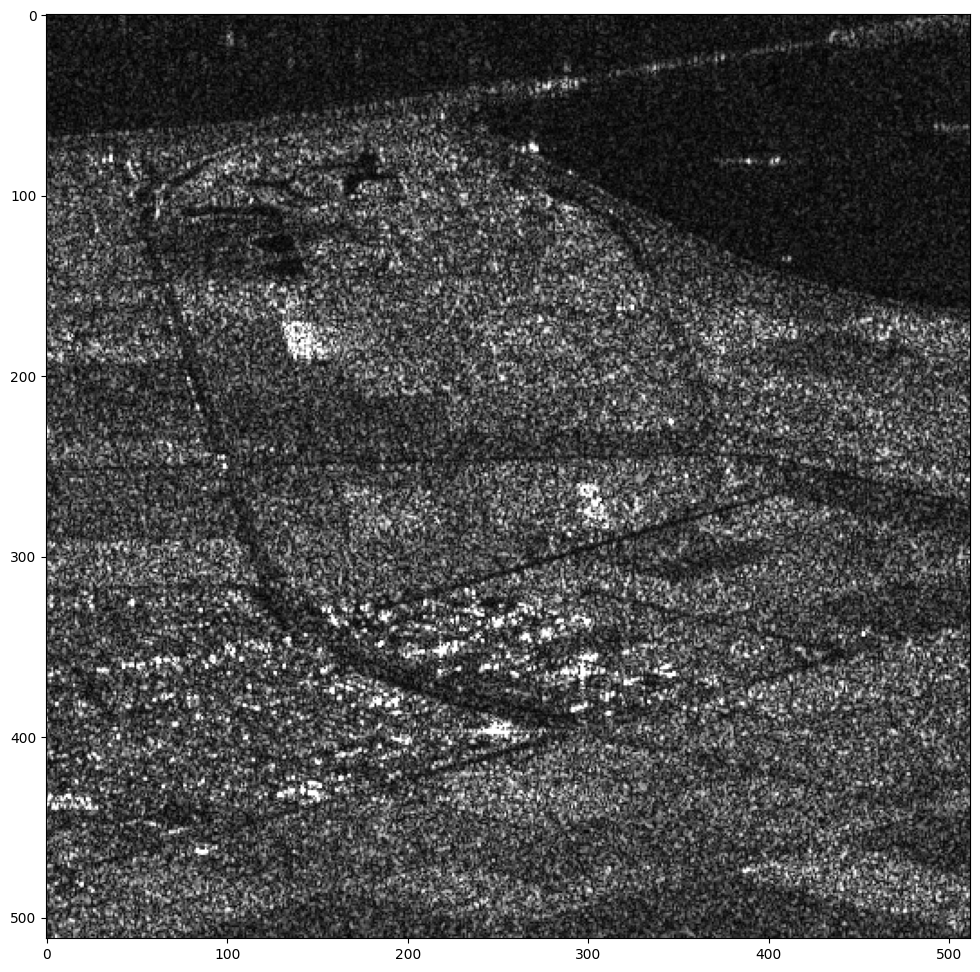

In [67]:
plot_sar(time_series_flipped[:,:,0])

### Question 1.3: Interpretation of a SAR image
The image contains
- an urban area,
- agricultural fields,
- water

Explain the appearence of these objects in the SAR image.

### Answer 1.3

- urban area: 
Urban regions produce very strong backscatter due to multiple reflections, especially from corner reflectors formed by walls and the ground. These areas appear very bright in SAR images. Their geometry also leads to geometric distortions like layover or shadowing in high-incidence configurations.

- agricultural fields: 
The backscatter from agricultural areas depends on the structure of the vegetation and soil moisture. Fields with dense or irregular vegetation produce volume scattering, as the radar signal interacts with multiple layers (leaves, stems, ground). This mechanism leads to moderate intensity and a more textured appearance than bare soil. If crops are aligned, like in plowed fields, the pattern can show directional effects depending on the radar look angle.

- water:
Water surfaces are smooth relative to the radar wavelength and reflect the signal away from the sensor, causing very low backscatter. They typically appear dark or black in the image.

### Question 1.4: Multitemporal analysis and change detection
To detect changes occurring between three dates, images can be displayed in a false colour representation, each date being one channel of a RGB image. Implement the function ```plot_changes```.

Then, choose three dates from the multitemporal stack (indexes from 0 to 24). From the false colour representation, can you tell when a particular change has occurred? Explain how you can interpret it.

### Answer 1.4

By looking at the RGB image, we can see which of the three dates has higher intensity in each area. Red corresponds to the first image, green to the second, and blue to the third. When one date has a stronger signal than the others, the corresponding color stands out. If two dates have strong values, we see a mix of their colors. When all three dates have similar values, the result is a greyish tone, meaning there's likely no significant change. So, changes over time appear through shifts in color: for example, a spot that goes from dark to green shows something changed mainly between the first and second date.

In [68]:
def plot_changes(im1,im2,im3):
    threshold = np.mean([im1, im2, im3]) + 3 * np.sqrt(np.var(im1+im2+im3))  # select a unique threshold for the three images
    # apply thresholding and shrinking of each image between [0;1] for RGB data
    im1 = np.clip(im1,0,threshold)
    im1 = im1/threshold
    im2 = np.clip(im2,0,threshold)
    im2 = im2/threshold
    im3 = np.clip(im3,0,threshold)
    im3 = im3/threshold
    image = np.stack([im1, im2, im3], axis=-1) # create a false RGB image by stacking the three dates
    plt.figure(figsize=(12,12))
    plt.imshow(image)
    plt.show()

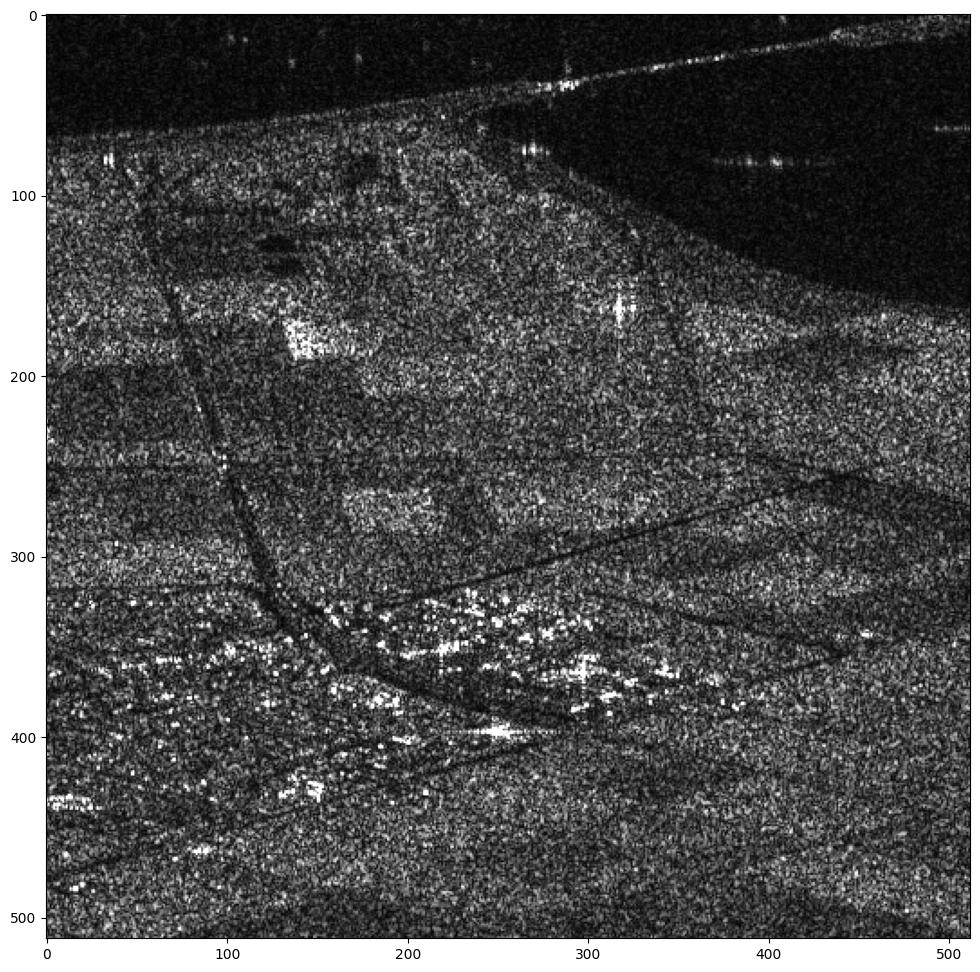

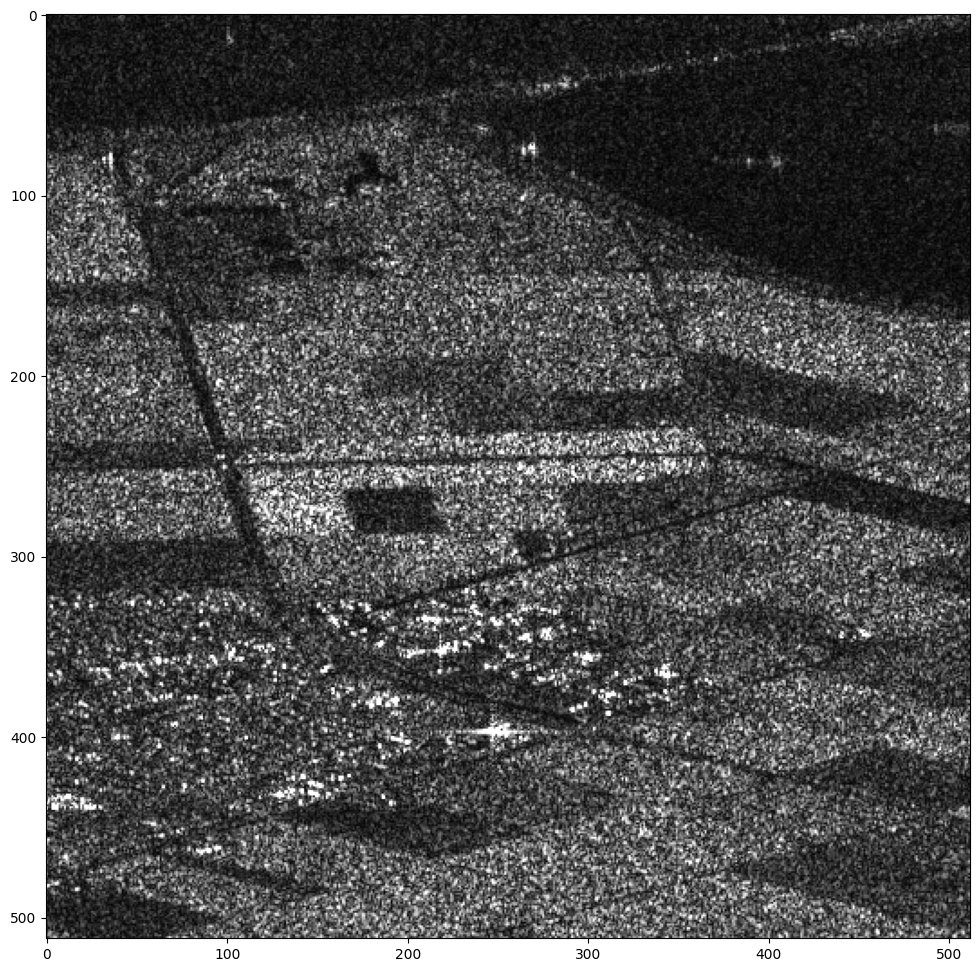

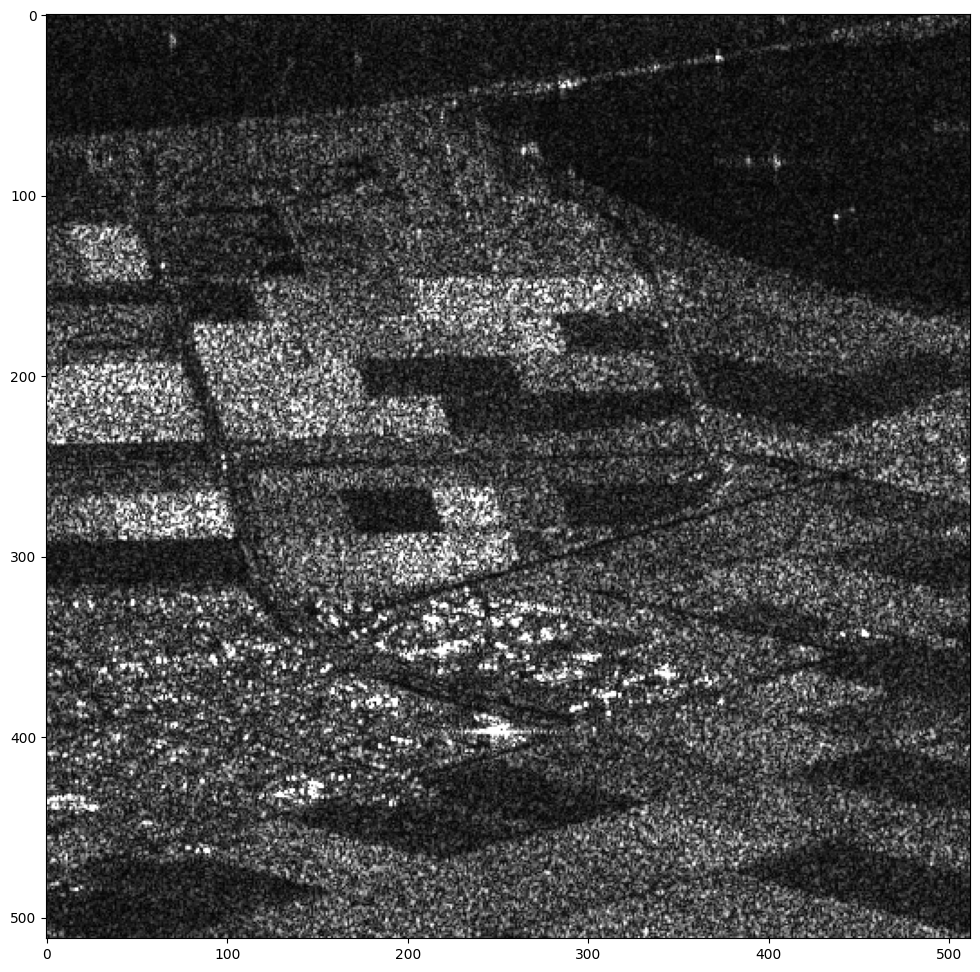

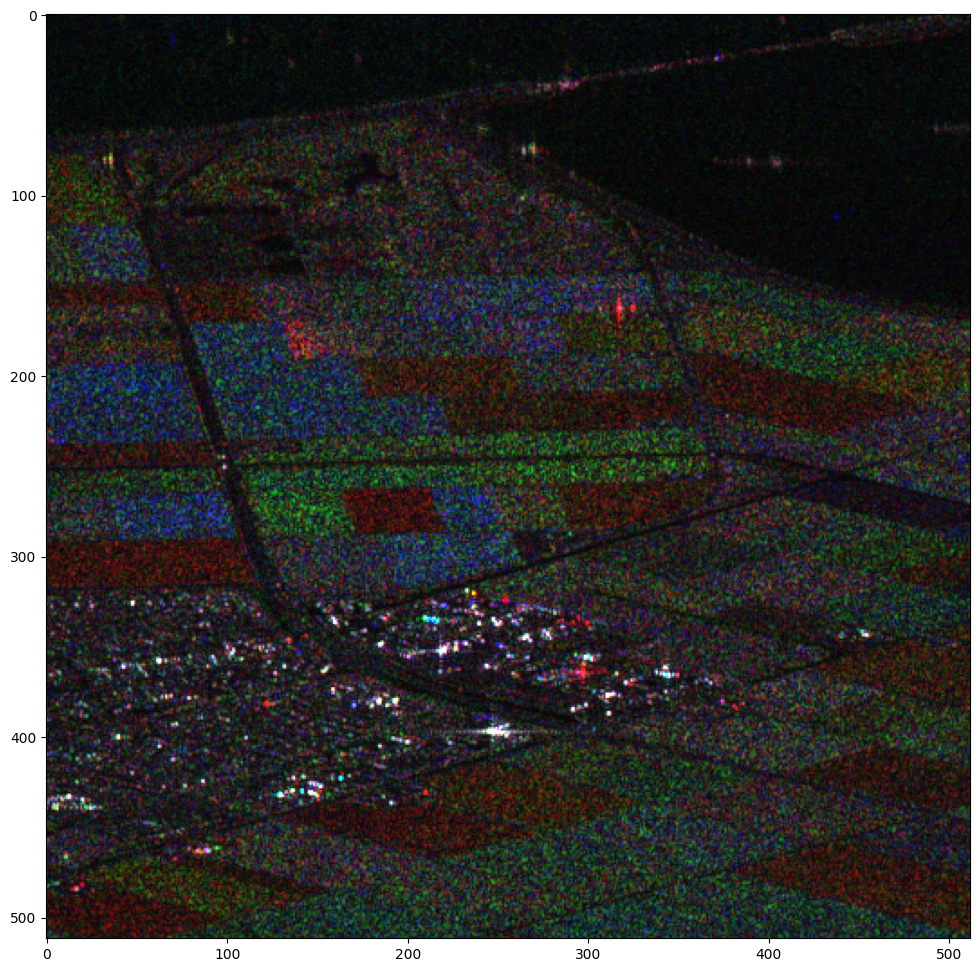

In [69]:
# choose three dates
idx1 = 1
idx2 = 10
idx3 = 15
im1 = time_series_flipped[:,:,idx1]
im2 = time_series_flipped[:,:,idx2]
im3 = time_series_flipped[:,:,idx3]

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

### Question 1.5: Create an image with isotropic pixels
The image pixels have the following size: $13.86[m]\times 2.3[m]$ in azimuth $\times$ range (approximately, pixel height is 5 times greater than pixel length). How can you create an image with approximately squared pixels?

PS : the range drection was the horizontal direction and the azimuth direction the vertical direction in the original image (before any flipping)

### Answer 1.5

We can compress the image vertically by a factor $azimuth/range$ to recover square pixels.

To do so, we first apply a averaging filter to smooth the image. This helps reducing the noise while resampling. Then we resample using biquadratic interpolation.

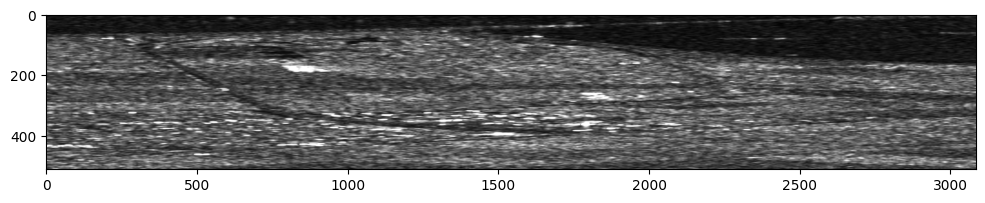

In [70]:
ima_tmp = time_series_flipped[:,:,0]

mask = np.ones((3, 3)) / 9
ima_filtered = scipy.ndimage.convolve(ima_tmp, mask, mode='reflect') # filter the image with the appropriate mask
ima_squared_pixels = scipy.ndimage.zoom(ima_filtered, zoom=(1, 13.86/2.3), order=2) # resample the filtered image
plot_sar(ima_squared_pixels)

## 2. Analysis of TerraSAR-X images acquired over the Paris area
In this part we will use an image of TerraSAR-X sensor (metric resolution) of Paris.
This is a temporal stack, you can choose the date you want.
(The questions are similar to the previous ones and will not be done during the PW but later as personal work).

imz2mat : version janvier 2018.  Fichier Ã  ouvrir : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.IMA
Nom compatible url
Nom compatible url
INFO - reading header/dim : https://perso.telecom-paristech.fr/tupin/TPSAR/paris/PileiEiffeljavelRECALZ4RECSP.dim
Multitemporal image 21 data
Fichiers PC
Image  complex short
lecture .dim OK -> largeur:2048 hauteur:2048 profondeur:21
Debug 2 2 2048
2 2048 <h
Affichage d'une image reelle
plt.show dans visusar : image 2048 x 2048


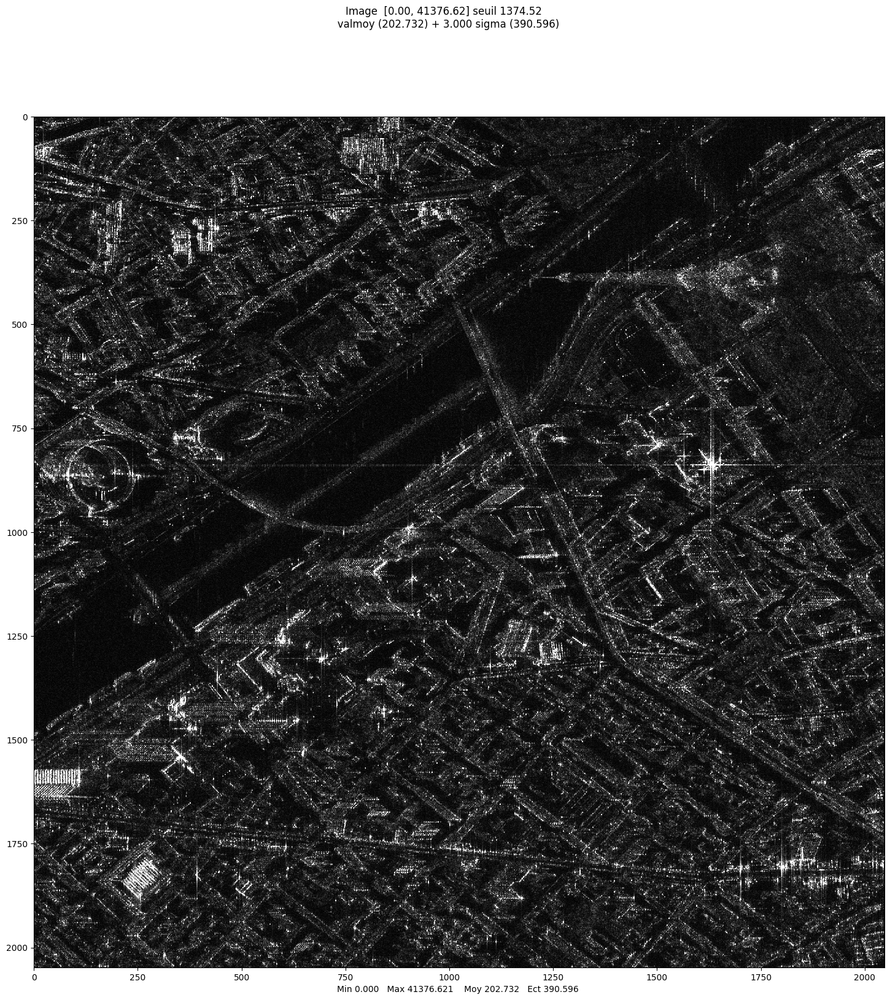

array([[ 58.30951895,  59.07622195, 145.77379737, ...,  22.84731932,
         42.05948169,   5.83095189],
       [ 90.00555538,  64.77653896, 117.08543889, ...,  41.76122604,
         17.80449381,   2.        ],
       [259.49373788, 153.83432647,  92.00543462, ..., 129.18978288,
         80.80222769,  43.18564576],
       ...,
       [132.37069162, 283.06359709, 409.33238328, ...,  88.05112151,
         62.03224968,  11.04536102],
       [ 36.76955262, 239.15058018, 382.41469637, ...,  11.        ,
         44.72135955,  10.        ],
       [100.56838469, 189.78145326, 234.04700383, ...,  17.49285568,
         94.42986816,   8.60232527]])

In [71]:
# 21 images from TerraSAR-X between 2009-01-24 and 2010-11-26
webpage='https://perso.telecom-paristech.fr/tupin/TPSAR/paris/'
image='PileiEiffeljavelRECALZ4RECSP.IMA'
im_slc_tsx_paris_liste=mvalab.imz2mat(webpage+image);
im_slc_tsx_paris = im_slc_tsx_paris_liste[0][:,:,0]
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(np.abs(im_slc_tsx_paris))

### Question 2.1: interpretation
Check that you recognize the main buildings on this image.
What is the position of the track of the sensor relatively to this image ?

Explain the appearence of the following buildings in the amplitude image : Eiffel Tower, Maison de la radio, Pont de Bir-Hakeim (you can use a [satellite optic image on googlemaps](https://www.google.com/maps/place/Eiffel+Tower/@48.851143,2.2797819,447m/data=!3m1!1e3!4m5!3m4!1s0x47e66e2964e34e2d:0x8ddca9ee380ef7e0!8m2!3d48.8583701!4d2.2944813) to help you).



### Answer 2.1

The sensor's track is positioned to the east of the image. This is evident from the projection of the Eiffel Tower on its left side.

The buildings appears differently based on their archiecture :
- Eiffel Tower : made of iron (higly reflective material), this is a prominent structure.
- La Maison de la radio : have a distinctive circular shape and is ocmposed of a lot of glass that returns the radar signals.
- Pont de Bir-Hakeim : due to its metal structure and its double deck design, it is easily recognizable on the TerraSAR-X image.

### Question 2.2: change detection
Identify and explain the appearence of some changing objects on Paris.

### Answer 2.2

We can see that the boats aren't in the same positions on the images, wich is pretty normal. We can also notice that some building were more reflective on the first image wich suggest that there have been some modifications on the buildings themselves.

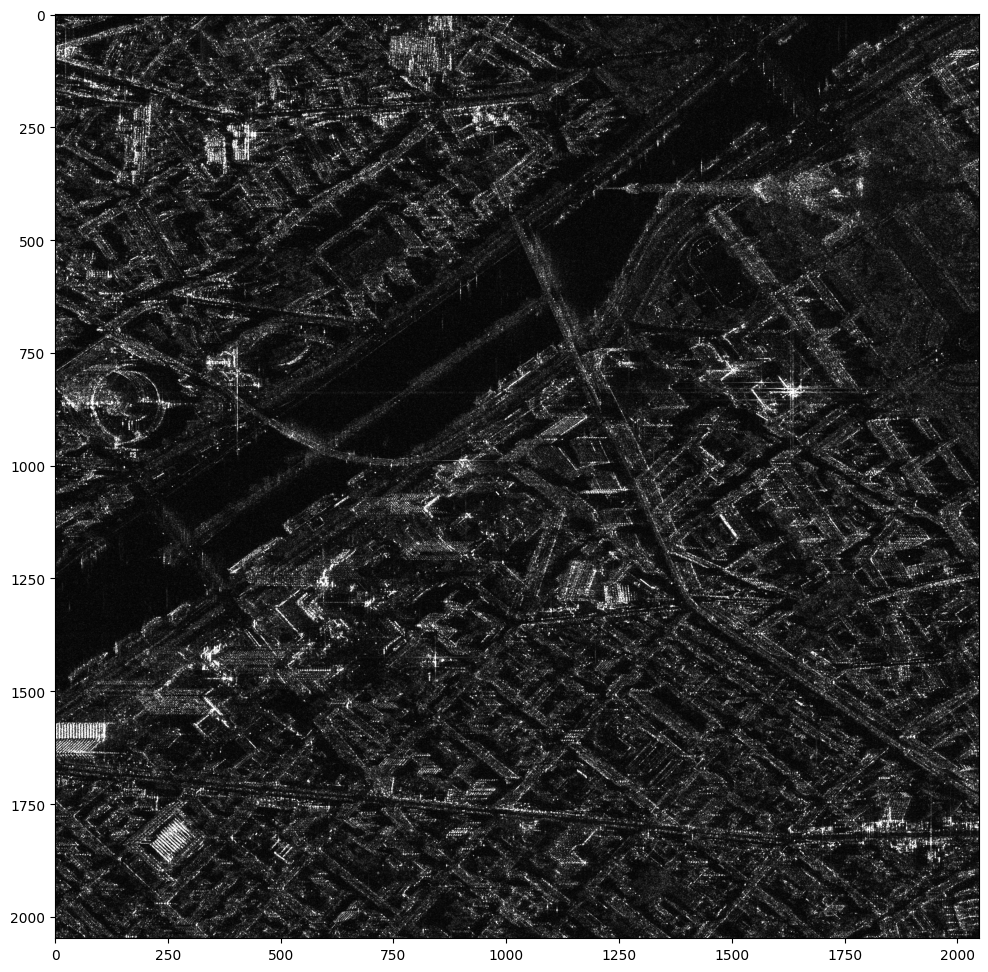

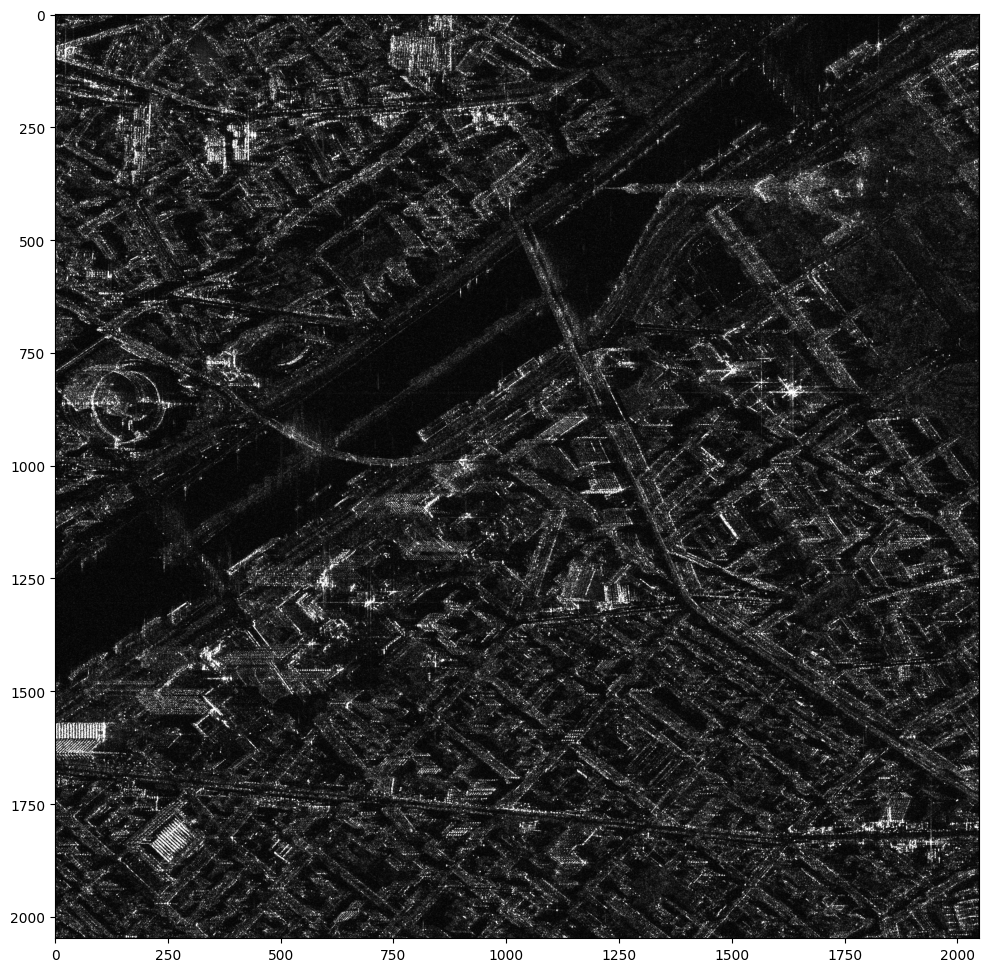

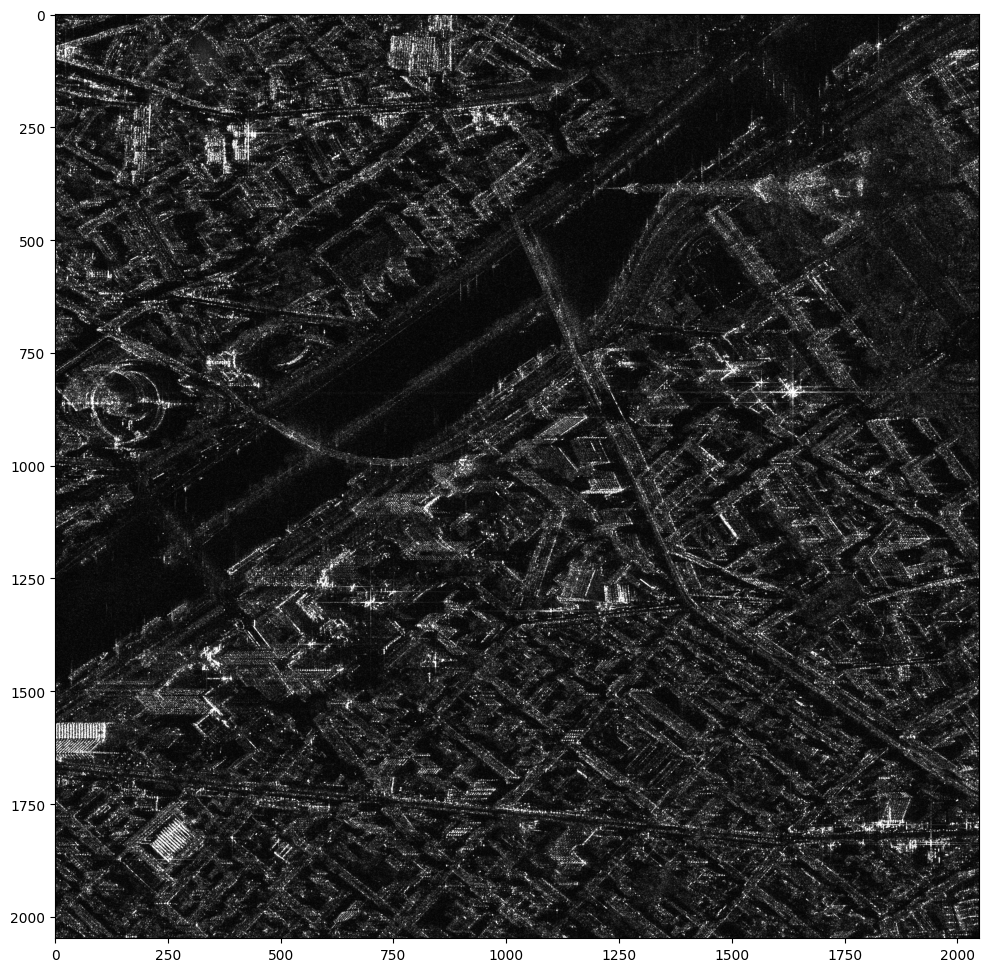

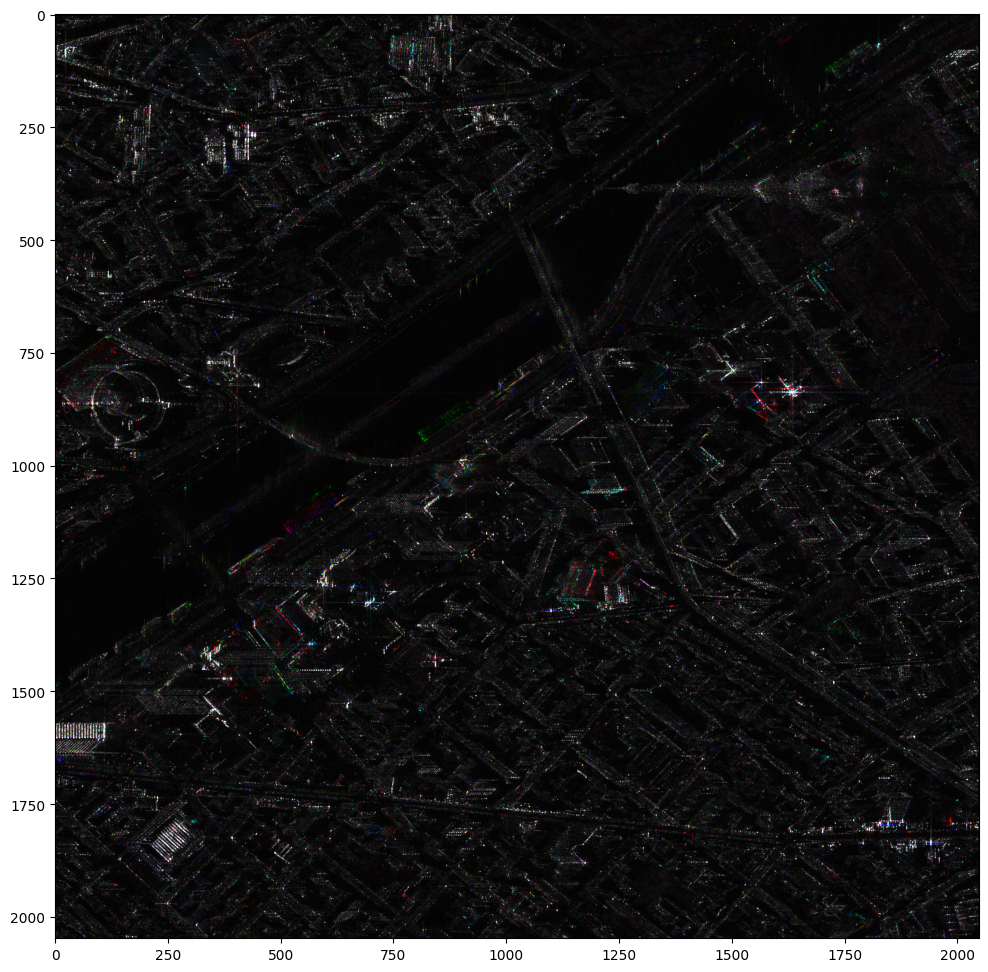

In [72]:
idx1 = 1
idx2 = 10
idx3 = 15
im1 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx1])
im2 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx2])
im3 = np.abs(im_slc_tsx_paris_liste[0][:,:,idx3])

plot_sar(im1)
plot_sar(im2)
plot_sar(im3)
plot_changes(im1,im2,im3)

## 3. SAR interferometry
In this part, the objective is to see the content of the phase of a SAR image and to do a simple processing chain to obtain an interferogram with topographic fringes.
You will be able to have a look to the optical image [on this link](https://g.page/ParcoEtna?share)

'wget' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.
'wget' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.


Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


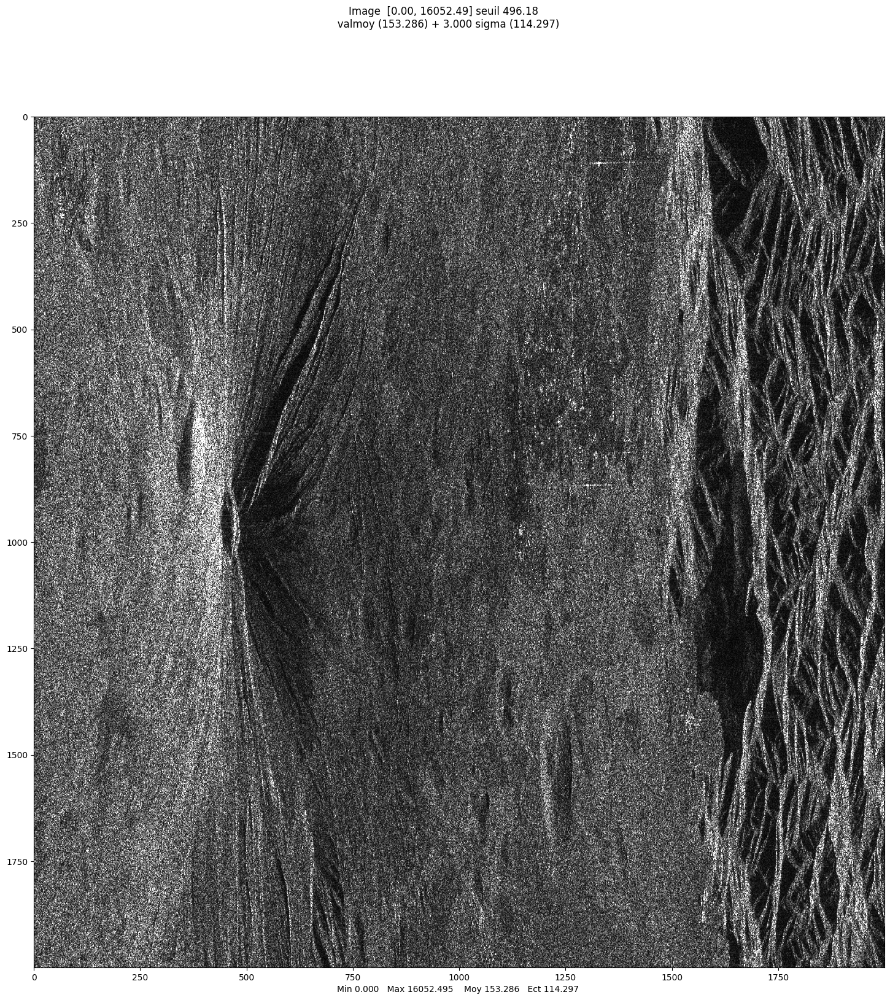

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


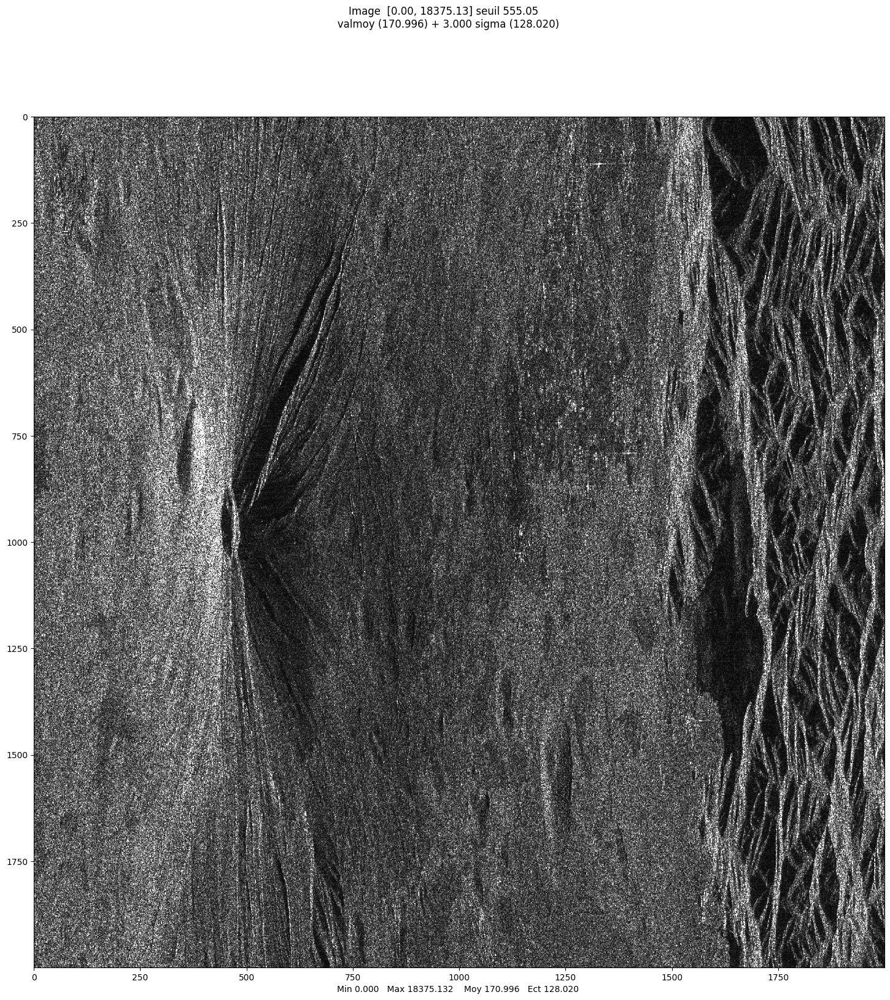

array([[246.54614173, 283.98943642,  94.86832981, ..., 499.65287951,
         82.00609733, 555.05417664],
       [257.41989045, 199.25109786, 141.73566947, ..., 399.60605601,
         55.        , 385.81083448],
       [146.10954794,  62.03224968,  77.79460136, ...,  67.08203932,
        205.24375752, 155.95512175],
       ...,
       [254.2380774 , 237.76669237, 199.58206332, ...,  72.9451849 ,
         43.68065934,  74.43117626],
       [182.00274723, 226.37358503, 142.5622671 , ...,  91.58602513,
         45.48626166,  31.        ],
       [ 57.97413216, 237.76038358, 143.58969322, ...,  72.99315036,
         74.72616677,  77.1038261 ]])

In [73]:
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Master.mat
!wget https://perso.telecom-paristech.fr/tupin/TPSAR/interfero/Slave.mat
imageM='./Master.mat'
imageS='./Slave.mat'
imamaitre=mvalab.matlab2imz(imageM,'Master')
imaslave=mvalab.matlab2imz(imageS,'Slave')

imamaitre = imamaitre[0][1000:3000,:]
imaslave = imaslave[0][1000:3000,:]
ncolonnes=imamaitre.shape[1]
nlignes=imamaitre.shape[0]

#%%
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visusar(imamaitre)
mvalab.visusar(imaslave)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


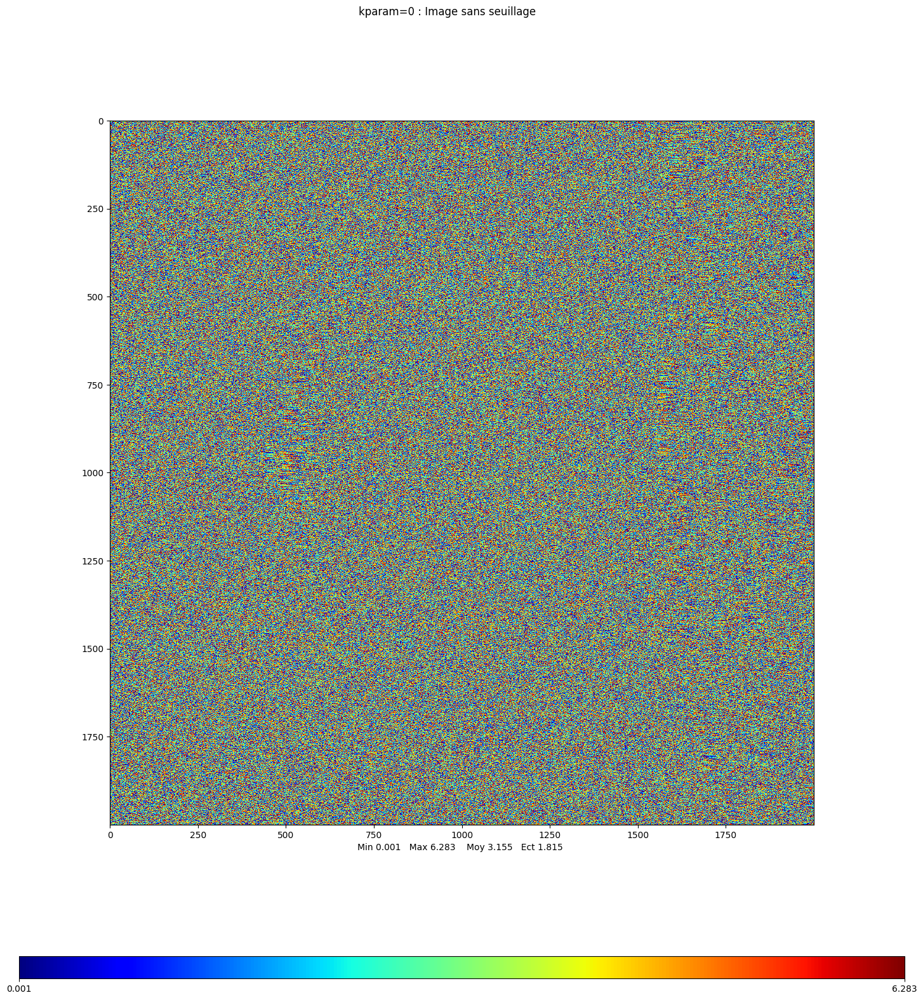

array([[6.12759048, 4.74305421, 4.41221781, ..., 1.9513027 , 5.200422  ,
        6.0785435 ],
       [0.78539816, 0.03569911, 0.609806  , ..., 2.89193238, 2.15744024,
        1.01336524],
       [1.61077501, 2.02577363, 2.68329259, ..., 5.24820022, 4.04275003,
        3.41047529],
       ...,
       [1.85360554, 1.2715139 , 1.81236203, ..., 3.18807078, 5.0244311 ,
        5.62461942],
       [4.13432394, 2.56347441, 0.83571537, ..., 0.14888995, 0.54937448,
        1.62479783],
       [0.04521802, 3.98984498, 3.34584682, ..., 2.89161403, 0.70862627,
        5.60998996]])

In [74]:
# display the phase of one image
#mvalab.visuinterfero uses an adapted lut to see the phase of an image
mvalab.visuinterfero(np.angle(imamaitre)+math.pi,0)


### Question 3.1
Do you recognize the area in the amplitude images ? Give a short interpretation. Visualize the phase of an image. Do you see any useful information?

### Answer 3.1
The area is hard to recognize as there is a lot of geometric deformation.

### Question 3.2
Compute the interferogram by computing $z_1.z_2^*$ and display the phase. Do you see any structured pattern ?

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


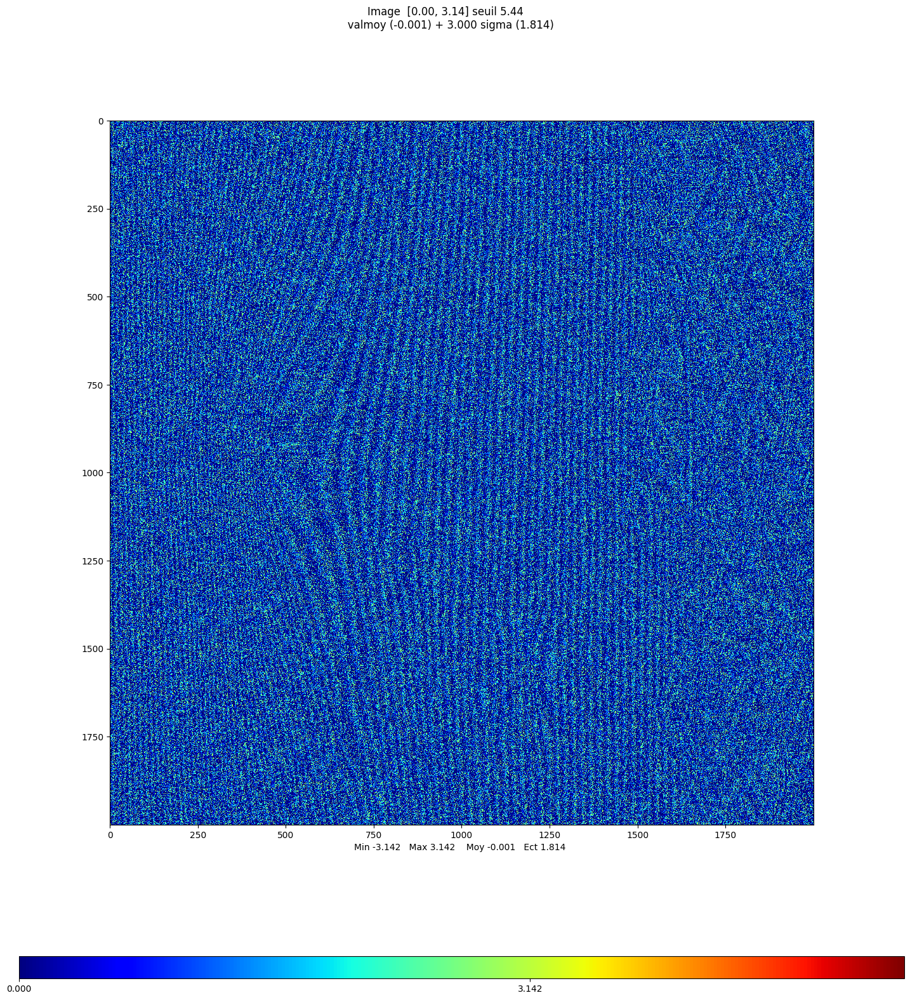

array([[5.44027968, 0.        , 0.        , ..., 0.        , 0.        ,
        0.25048328],
       [0.        , 0.        , 0.01006225, ..., 0.        , 0.        ,
        0.        ],
       [2.8468345 , 0.        , 0.30891828, ..., 0.99945885, 0.94989923,
        1.5869244 ],
       ...,
       [0.        , 0.        , 3.0408085 , ..., 0.        , 0.        ,
        1.44804168],
       [0.        , 0.        , 1.81072715, ..., 0.        , 0.        ,
        0.0540015 ],
       [0.        , 0.        , 3.04171558, ..., 0.        , 2.55036945,
        0.94950238]])

In [75]:
raw_interf = np.angle(imamaitre*np.conj(imaslave)) # compute z1.z2*
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visuinterfero(raw_interf) # diplay the phase 

### Answer 3.2
We can see a pattern of vertical lines.

### Question 3.3: Registration of the two images
To compute an interferogram, the following steps have to be applied :
- registration of the two images (only a translation is searched)
- suppression of the vertical fringe pattern
- filtering to improve the phase information.

Using the knowledge acquired on previous courses, propose a method and apply it to do the registration between the two images. Complete the code below.

Affichage d'une image complexe : on prend le module
plt.show dans visusar : image 2000 x 2000


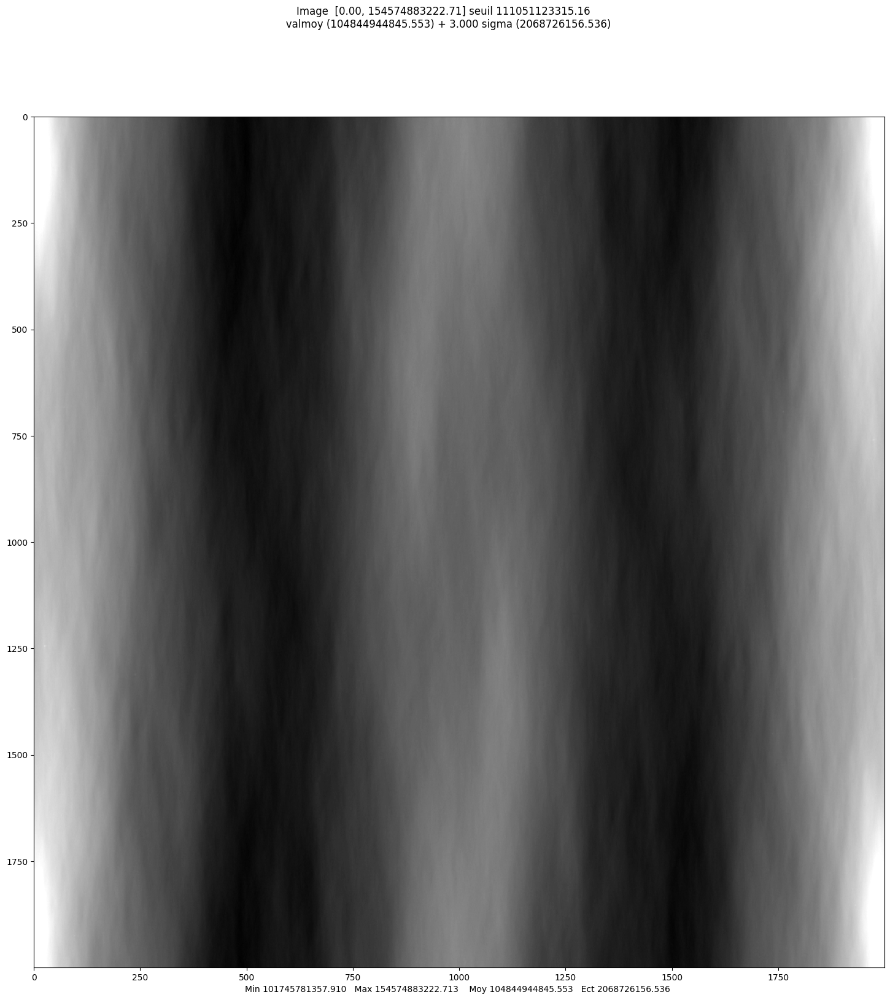

(np.int64(2), np.int64(0))
Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


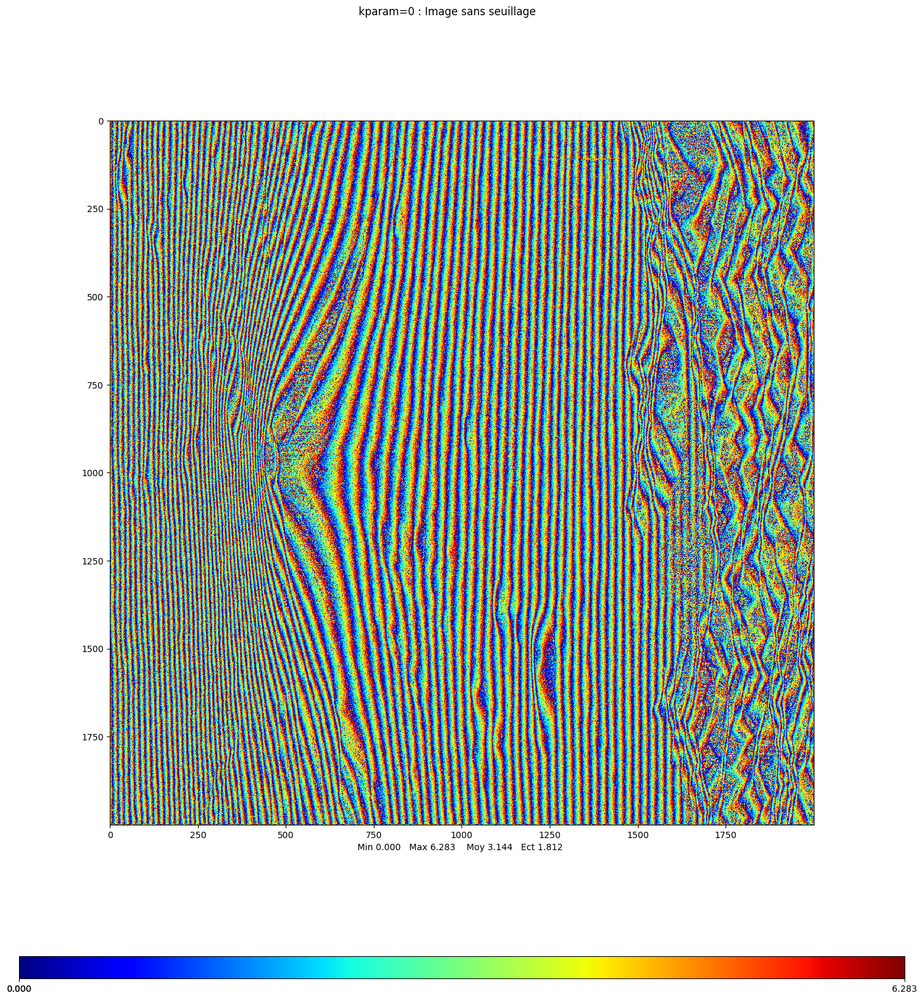

array([[4.22205732, 4.71080733, 5.17943616, ..., 0.84415399, 5.24916385,
        1.11339996],
       [4.88475065, 4.36758172, 4.71439299, ..., 5.99860473, 6.17553618,
        1.2324965 ],
       [4.49176528, 4.6466379 , 4.50604421, ..., 2.97654948, 0.68942589,
        1.65815508],
       ...,
       [3.68611537, 4.33310887, 4.64982345, ..., 3.02292211, 3.72458163,
        4.1057245 ],
       [0.56173994, 5.89279441, 4.58285269, ..., 1.30349405, 2.10797629,
        5.22151557],
       [0.1502983 , 5.18013493, 5.88769572, ..., 1.95881336, 0.06512516,
        0.96244501]])

In [76]:
# propose a method to extract the shift along the two axes
# to compute the correlation efficiently you can use the FFT 

# using the multiplication in the Fourier domain, compute the FFT of the correlation and then the correlation by inverse FFT
imacorfft = np.fft.fft2(np.abs(imaslave)) * np.conj(np.fft.fft2(np.abs(imamaitre))) # to be completed
imacor= np.fft.ifft2(imacorfft) # to be completed

#visualize the correlation image (maximum gives the translation value)
mvalab.visusar(imacor)
ishift = np.unravel_index(np.argmax(imacor),imacor.shape) # you can use np.argmax and np.unravel_index
print(ishift)

# compute the shift on the two axis
imaslaveroll=np.roll(imaslave, -ishift[0], axis=0)
imaslaveroll=np.roll(imaslaveroll, -ishift[1], axis=1)

# compute the interferogram and plot the interferometric phase
interfero= imamaitre*np.conj(imaslaveroll) # to be completed
plt.rcParams['figure.figsize'] = [18, 18]
mvalab.visuinterfero(np.angle(interfero)+math.pi,0)

### Question 3.4
What is the shift between the two images ? Which pattern do you see in the resulting fringes when computing the interferogram after the registration ?

### Answer 3.4
There is a horizontal shift of two pixel. We can see more clearly the pattern with the vertical lines in the interferogram after the registration. For example the patterns on the right side of the image is way more recognizable.

### Question 3.5: Suppression of the orbital fringes
To obtain the useful information about the topography the so-called orbital fringes have to be suppressed. It can be done by using the sensor parameters but in this practical work we propose to use a signal processing method.
How can you detect a pure sinusoid in a signal ? (it is the case of the pattern we would like to suppress in the horizontal direction). Compute the frequency of this pattern and use it to suppress it in the registered secondary image.

Which frequency did you obtain ? Is it the same for all the considered lines ? What do you see in the resulting interferogram after correction ?

c:\Users\nonoa\.pyenv\pyenv-win\versions\3.12.8\Lib\site-packages\matplotlib\cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
c:\Users\nonoa\.pyenv\pyenv-win\versions\3.12.8\Lib\site-packages\numpy\ma\core.py:3413: ComplexWarning: Casting complex values to real discards the imaginary part
  _data[indx] = dval
c:\Users\nonoa\.pyenv\pyenv-win\versions\3.12.8\Lib\site-packages\matplotlib\cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


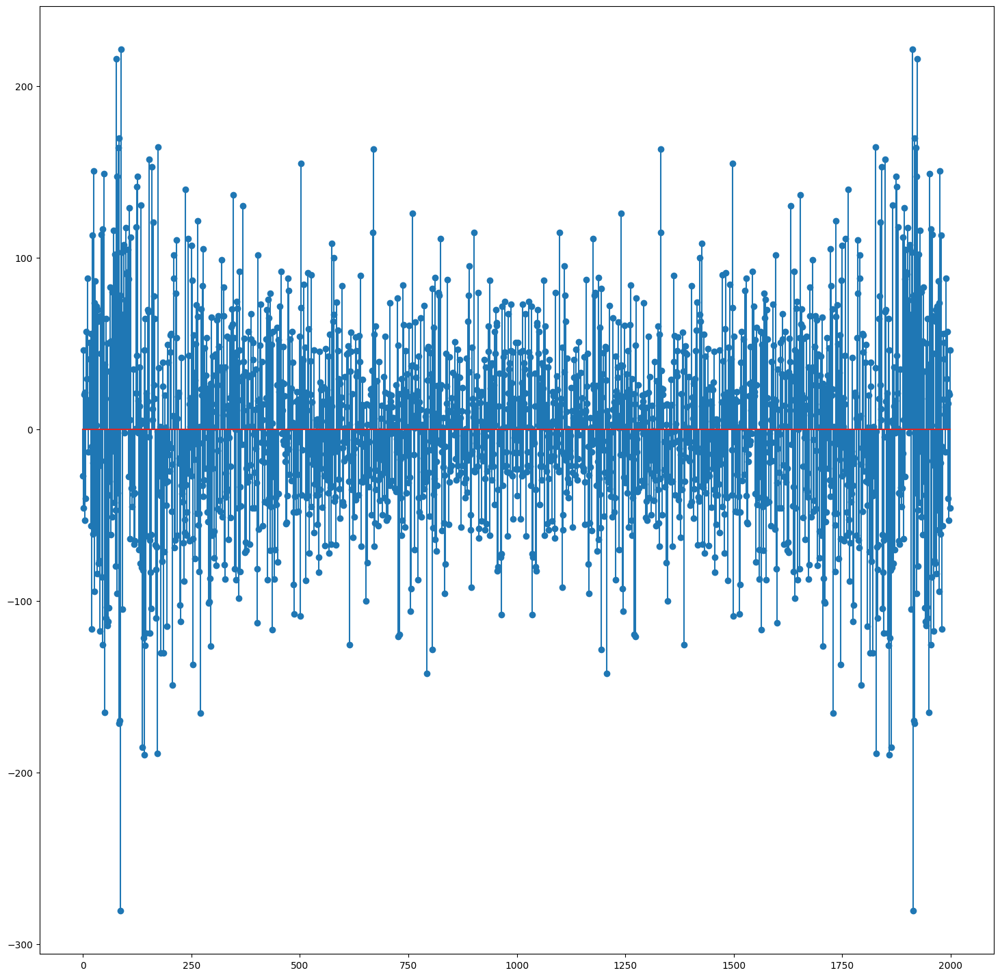

(np.int64(75),)


In [77]:
# compute the main frequency of the pattern by choosing a line in the image and using the FFT
fftfringe = np.fft.fft(np.angle(interfero)[1000, :]) # to be completed
plt.figure()
plt.stem(fftfringe)
plt.show()

freq = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)
print(freq)

In [78]:
# compute the main frequency of the pattern by choosing a line in the image and using the FFT

for i in range(0, 2000, 100):
    fftfringe = np.fft.fft(np.angle(interfero)[i, :]) # to be completed

    freq = np.unravel_index(np.argmax(np.abs(fftfringe)), fftfringe.shape)

    print(f"line index : {i}, freq : {freq}")



line index : 0, freq : (np.int64(88),)
line index : 100, freq : (np.int64(1918),)
line index : 200, freq : (np.int64(89),)
line index : 300, freq : (np.int64(1920),)
line index : 400, freq : (np.int64(86),)
line index : 500, freq : (np.int64(88),)
line index : 600, freq : (np.int64(1923),)
line index : 700, freq : (np.int64(75),)
line index : 800, freq : (np.int64(87),)
line index : 900, freq : (np.int64(78),)
line index : 1000, freq : (np.int64(75),)
line index : 1100, freq : (np.int64(79),)
line index : 1200, freq : (np.int64(1923),)
line index : 1300, freq : (np.int64(81),)
line index : 1400, freq : (np.int64(82),)
line index : 1500, freq : (np.int64(83),)
line index : 1600, freq : (np.int64(83),)
line index : 1700, freq : (np.int64(1916),)
line index : 1800, freq : (np.int64(85),)
line index : 1900, freq : (np.int64(83),)


### Answer 3.5a

We can detect a pure sinusoid in a signal by identifying the maximum value in the Fourier domain. The frequency is approximately 80, as observed from the average analysis across all lines of the signal. Occasionally, we obtain a frequency of 1920, which is expected because it is 2000−80, reflecting the symmetry and periodicity of the Discrete Fourier Transform.

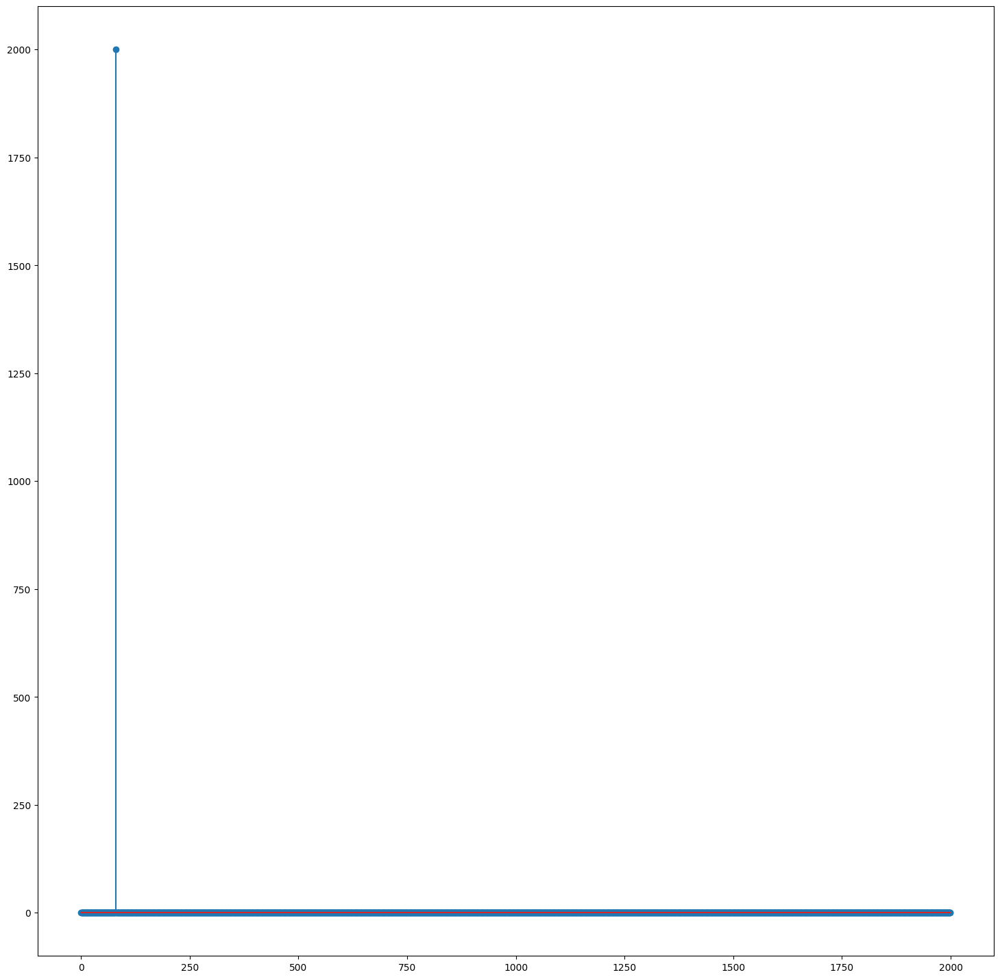

In [99]:
N = interfero.shape[1]
n = np.arange(0,N)
onde = np.exp(1j*n* 2*np.pi*80/N)  # create a pure wave using the previously computed frequency freq
fonde = np.abs(np.fft.fft(onde))
plt.figure()
plt.stem(fonde)
plt.show()

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


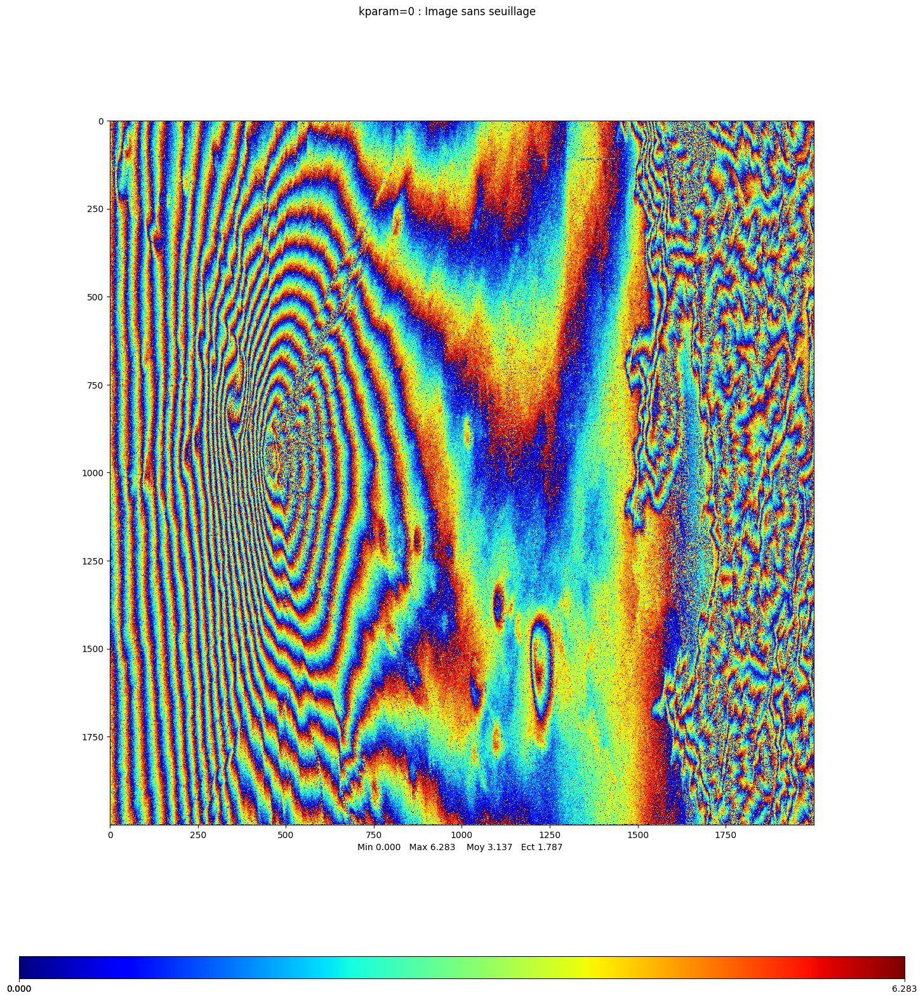

array([[4.22205732, 4.45947992, 4.67678133, ..., 1.59813622, 5.75181867,
        1.36472737],
       [4.88475065, 4.1162543 , 4.21173816, ..., 0.46940166, 0.39500569,
        1.48382391],
       [4.49176528, 4.39531048, 4.00338938, ..., 3.73053172, 1.19208071,
        1.9094825 ],
       ...,
       [3.68611537, 4.08178146, 4.14716863, ..., 3.77690434, 4.22723645,
        4.35705191],
       [0.56173994, 5.641467  , 4.08019786, ..., 2.05747629, 2.61063112,
        5.47284298],
       [0.1502983 , 4.92880751, 5.3850409 , ..., 2.7127956 , 0.56777999,
        1.21377242]])

In [101]:
# suppress the pattern by multiplying the interferogram by the conjugate of the pure wave
interferofine= np.multiply(interfero,np.conj(onde))

mvalab.visuinterfero(np.angle(interferofine)+math.pi,0)

### Answer 3.5b

We can see that we removed the vertical lines pattern on the interferogram. We can now regnoize the pattern of the Mont Etna.

### Question 3.6: interferogram filtering
To improve the quality of the interferogram, some filtering can be applied to reduce the phase noise. Propose a suitable kernel by filling the code below.

How does the filtered interferogram look like?

### Answer 3.6
We can apply an averaging kernel in order to reduce the noise.

In [104]:
def interferogramme( tabvignette, tabvignette2, *therest) :
    """
    Computation of the complex interferogram between two images of the
    same size.
    By default, window size is set as 3x3 (dimx, dimy).
    It outputs a complex image, whose modulus is the coherence and whose phase
    is the interferometric phase.
    """

    dimx=3
    dimy=3

    if(len(therest)==1):
        dimx=therest[0]
        dimy=dimx

    if(len(therest)==2):
        dimx=therest[0]
        dimy=therest[1]

    nlig=np.size(tabvignette,0)
    ncol=np.size(tabvignette,1)

    if nlig != np.size(tabvignette2,0)  :
        print(u'les deux images doivent avoir la même taille (%d  et %d)'%(nlig, np.size(tabvignette2,0)))
        return 0

    if ncol != np.size(tabvignette2,1)  :
        print(u'les deux images doivent avoir la même taille')
        return 0

    interf= np.multiply(tabvignette, np.conj(tabvignette2))

    # part to be completed to compute a multi-look interfergram by averaging on a local window


    mask = np.ones([dimx,  dimy])/(dimx*dimy) # to be completed
    interfiltr = signal.convolve2d(interf,mask,mode='same')

    den1 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette)),mask,mode='same'))
    den2 = np.sqrt(signal.convolve2d(np.square(np.abs(tabvignette2)),mask,mode='same'))

    return interfiltr/(den1*den2+1e-12)

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


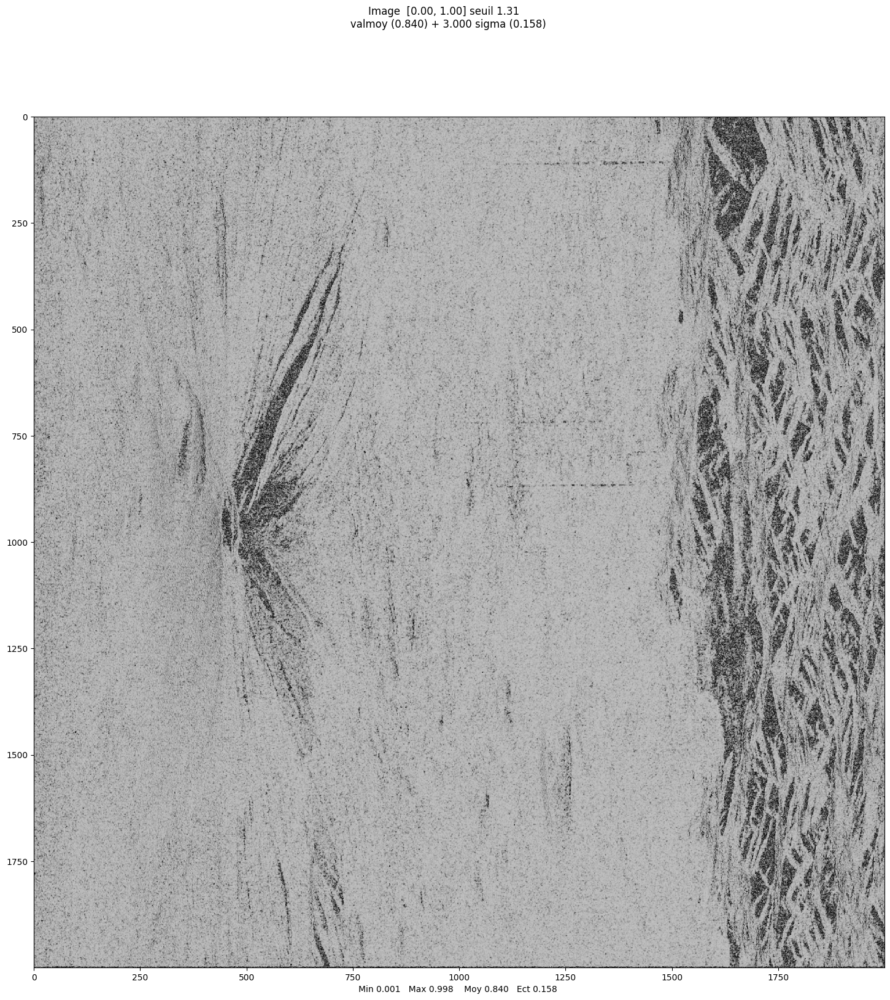

Affichage d'une image reelle
plt.show dans visusar : image 2000 x 2000


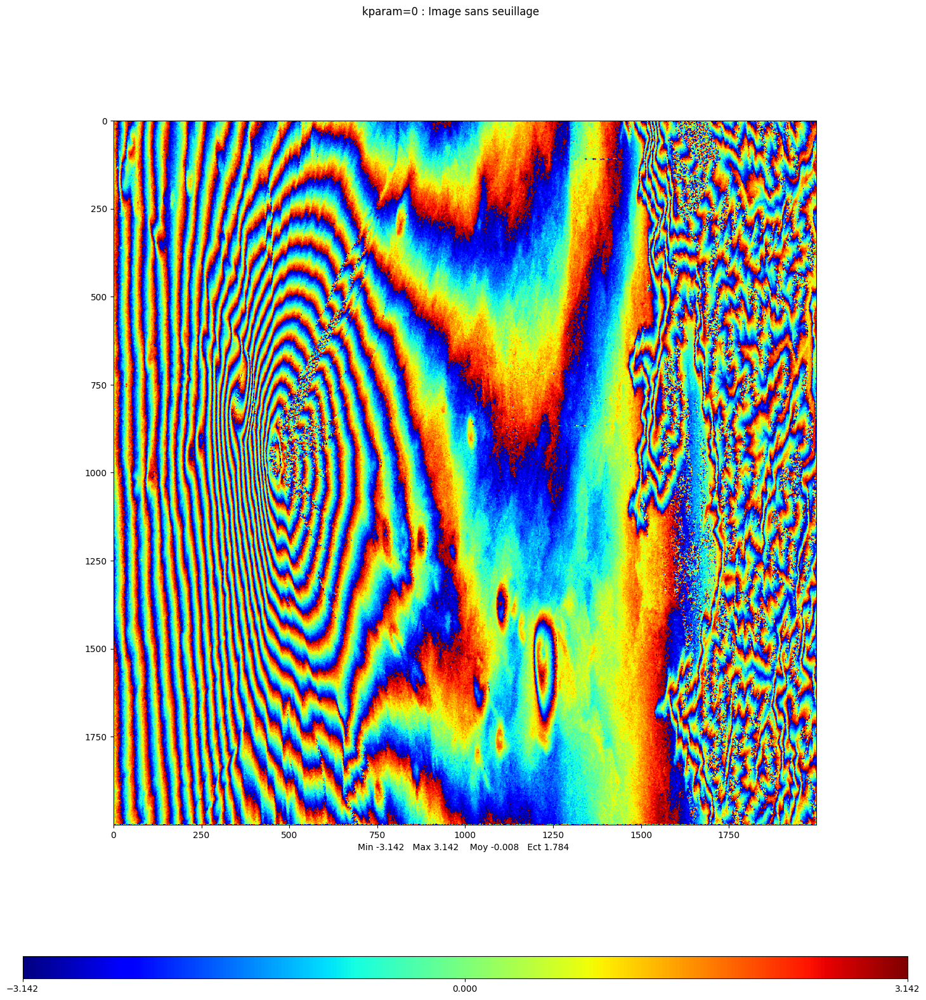

array([[ 1.23830006,  1.23744177,  1.7097922 , ..., -2.55059845,
        -2.34188489, -2.24534068],
       [ 1.26750758,  1.24068355,  1.56530351, ..., -2.51466517,
        -2.16656542, -2.03069313],
       [ 1.49824622,  1.42714215,  1.50994674, ..., -2.69369832,
        -2.40773251, -2.15616229],
       ...,
       [ 1.15540477,  1.09550862,  1.19631304, ...,  0.03025288,
         0.63565601,  1.83792859],
       [ 2.48876953,  2.31491948,  1.50267917, ..., -0.10724107,
        -1.04046286, -2.95534065],
       [ 3.06965895,  2.92324419,  2.14385056, ..., -0.32988715,
        -1.28638597, -2.60009181]])

In [105]:
imaslavefine= np.multiply(imaslaveroll,onde)
filtered_interferogram = interferogramme(imamaitre,imaslavefine)
mvalab.visusar(np.abs(filtered_interferogram))
mvalab.visuinterfero(np.angle(filtered_interferogram),0)

### Question 3.7
Can you apply the convolution directly on the interferometric phase image ?
What would happen in that case?

This wouldn't work because it breaks the modular nature of the phase.